In [23]:
import time
import json
import pprint as pp

from IPython.display import display, Markdown, Latex
#display(Markdown('*some markdown* $\phi$'))

import pandas as pd
from IPython.display import display, HTML

from shapely.geometry import box
from shapely.geometry import Point
import shapely.geometry

from shapely import wkt


# from gbdx_auth import gbdx_auth
# gbdx = gbdx_auth.get_session()

from gbdxtools import Interface
gbdx = Interface()


from gbdxtools.task import env
from gbdxtools import CatalogImage, WV03_VNIR, WV03_SWIR  

%matplotlib inline

In [45]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

def plot(image, w=30, h=24, cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.show()

def climplot(image,lower,upper, w=30, h=24,  cmap='jet'):
    f, ax = plt.subplots(1, figsize=(w,h))
    ax.axis('off')
    plt.imshow(image, cmap=cmap)
    plt.colorbar()
    plt.clim(lower, upper)
    plt.show()

In [36]:
def calc_ecarr_redred(cimg):
    green = cimg[2,:,:]
    red = cimg[4,:,:]
    rededge = cimg[5,:,:]
    ecarr = 0.0161 * ((red/(green*red)) ** 0.7784)
    return(ecarr)

In [6]:
blooms = pd.read_csv("newblooms.csv")
display(blooms)

,long,lat
0,153.024202,-29.194401
1,152.965632,-29.057304
2,153.032432,-29.011527
3,153.142790,-28.967884
4,153.101445,-28.823379
5,153.123300,-28.742677
6,153.149534,-28.730539
7,153.181088,-28.720017
8,153.293630,-28.726067
9,153.289754,-28.928794


In [54]:
pointList = []
for i in range(len(blooms)):
    x = blooms.iloc[i]
    pointList.append(Point(x.long,x.lat))

poly = shapely.geometry.Polygon([[p.x, p.y] for p in pointList]).buffer(0.05)

In [56]:
poly.bounds
wkt.dumps(poly)

'MULTIPOLYGON (((153.0869436905976215 -29.0437372921561412, 153.0930329420553733 -28.9642145523641688, 153.0936115691819737 -28.9595507313626719, 153.0946255158779934 -28.9549618374018891, 153.0960658245182344 -28.9504884106721327, 153.0979197708194874 -28.9461699712783513, 153.1001709762520591 -28.9420446701031757, 153.1027995527346093 -28.9381489517661912, 153.1057822783334927 -28.9345172326570825, 153.1090928024150912 -28.9311815968869865, 153.1686644492414473 -28.8765505526312474, 153.1908611100318183 -28.9541301503458968, 153.1919778980689841 -28.9589089967379429, 153.1926208179952766 -28.9637743068336277, 153.1927836760259538 -28.9686792090365870, 153.1924649032135619 -28.9735764503266253, 153.1916675705629416 -28.9784188514875147, 153.1903993594455073 -28.9831597616238064, 153.1886724875983816 -28.9877535075878647, 153.1865035914205748 -28.9921558339874679, 153.1839135657007489 -28.9963243295349500, 153.1809273623202046 -29.0002188356305801, 153.1775737498706462 -29.003801833243

In [2]:
def findImageryFromLocation(n,start,end):
    x = blooms.iloc[n]
    bloomwkt = wkt.dumps(Point(x.long,x.lat).buffer(0.01))
    types = [ "DigitalGlobeAcquisition" ]
    results = gbdx.catalog.search(searchAreaWkt=bloomwkt,
                          startDate=start,
                          endDate=end,
                          types=types)
    
    rvv = pd.io.json.json_normalize(results)
    rv = rvv[['identifier','properties.timestamp','properties.cloudCover']]
    return(rv)

In [34]:
findImageryFromLocation(0,"2018-01-20T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010077902900,2018-08-11T02:50:53.000Z,1
4,10200100756B3000,2018-07-12T02:51:24.000Z,70
5,102001006FA1C900,2018-03-15T02:51:48.000Z,24


In [35]:
order_id_0 = gbdx.ordering.order(['1030010083D1C500','1020010077902900'])
print(order_id_0)

e70f5526-8d40-4fcd-a6bc-b3c2196301b1


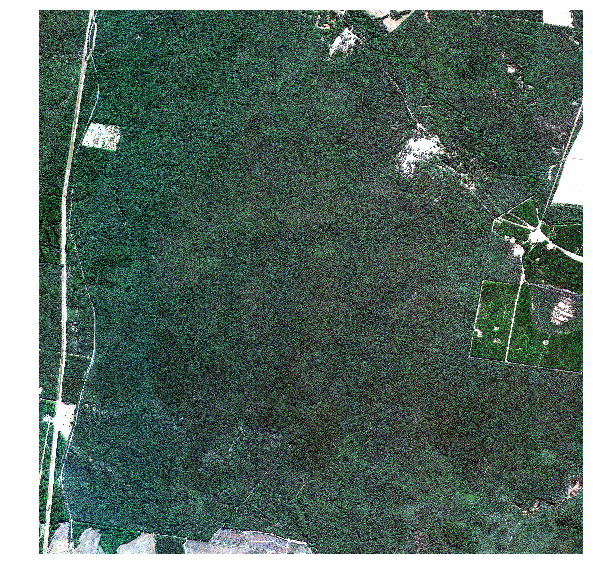

In [48]:
x0 = blooms.iloc[0]
p0large = Point(x0.long,x0.lat).buffer(0.04)
bloom0_7_23_large = CatalogImage('1030010083D1C500',bbox=p0large.bounds)
bloom0_7_23_large.plot()
#bloom0_8_11 = CatalogImage('1020010077902900',bbox=p0.bounds)

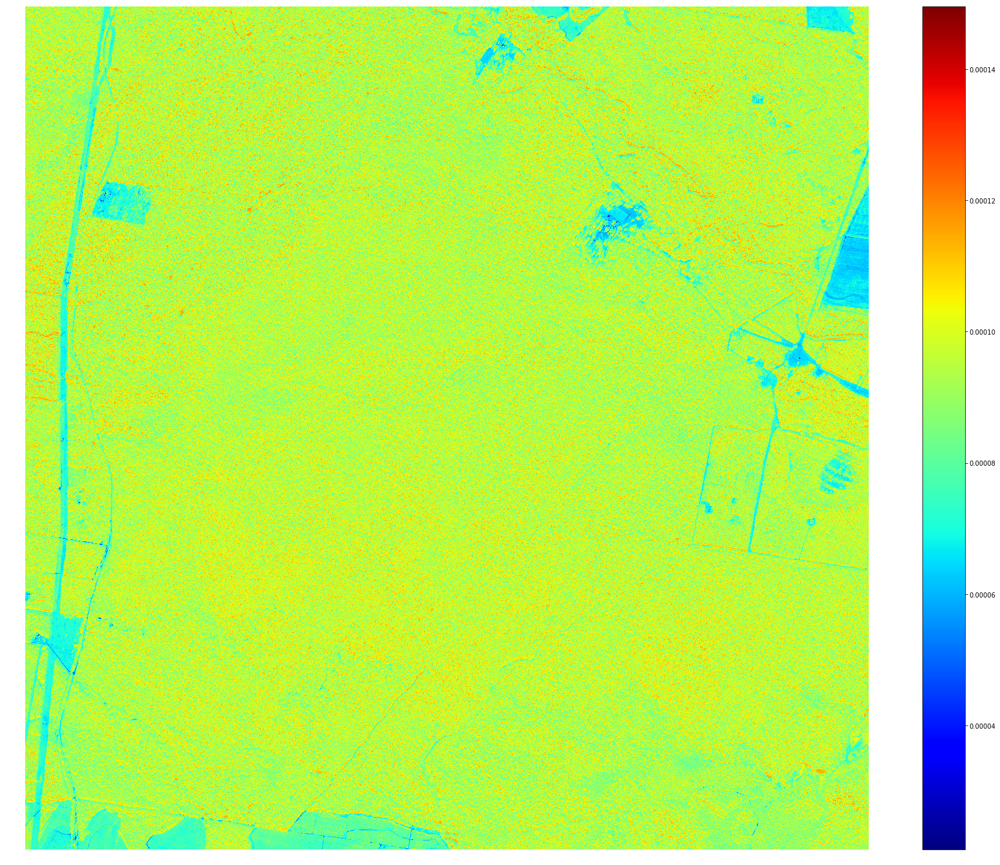

In [49]:
tredred0 = calc_ecarr_redred(bloom0_7_23_large)
plot(tredred0)

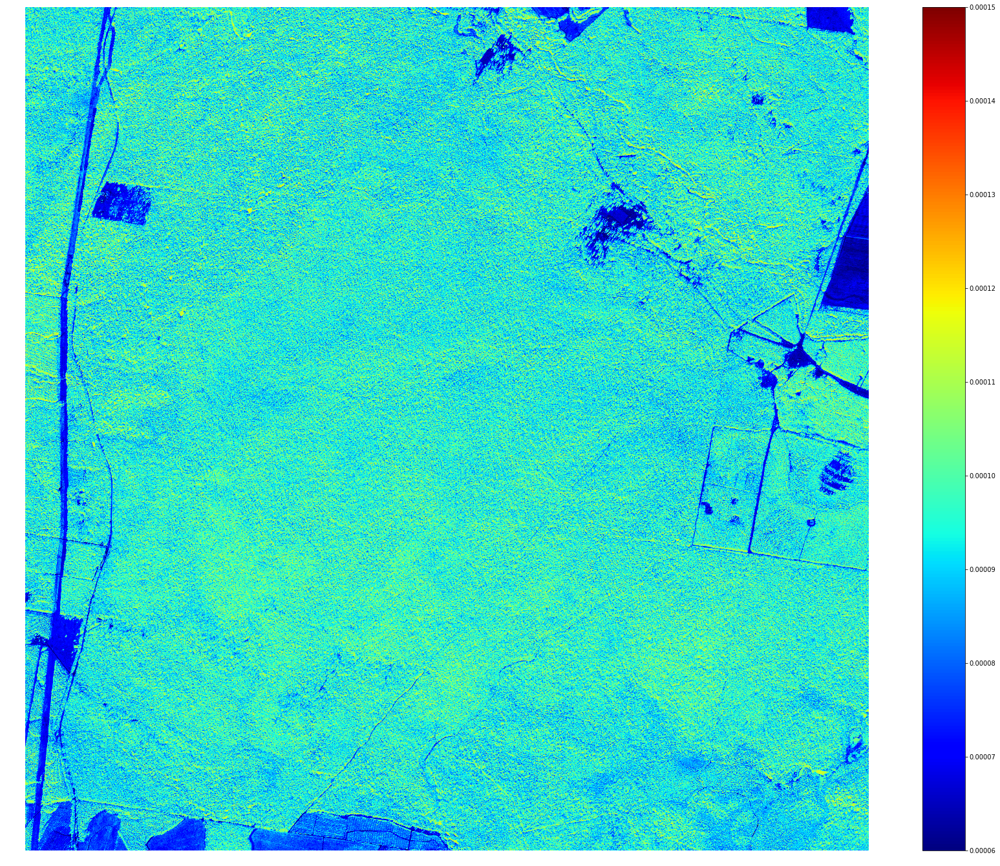

In [50]:
climplot(tredred0,0.00006,0.00015)

In [59]:
x0 = blooms.iloc[0]
p0 = Point(x0.long,x0.lat).buffer(0.01)
bloom0_7_23 = CatalogImage('1030010083D1C500',bbox=p0.bounds)
bloom0_8_11 = CatalogImage('1020010077902900',bbox=p0.bounds)

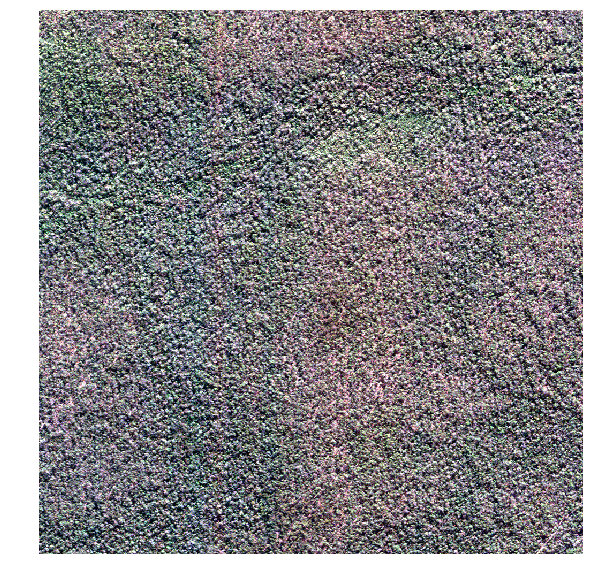

In [42]:
bloom0_7_23aoi = bloom0_7_23.aoi(wkt=wkt.dumps(p0))
bloom0_7_23aoi.plot()

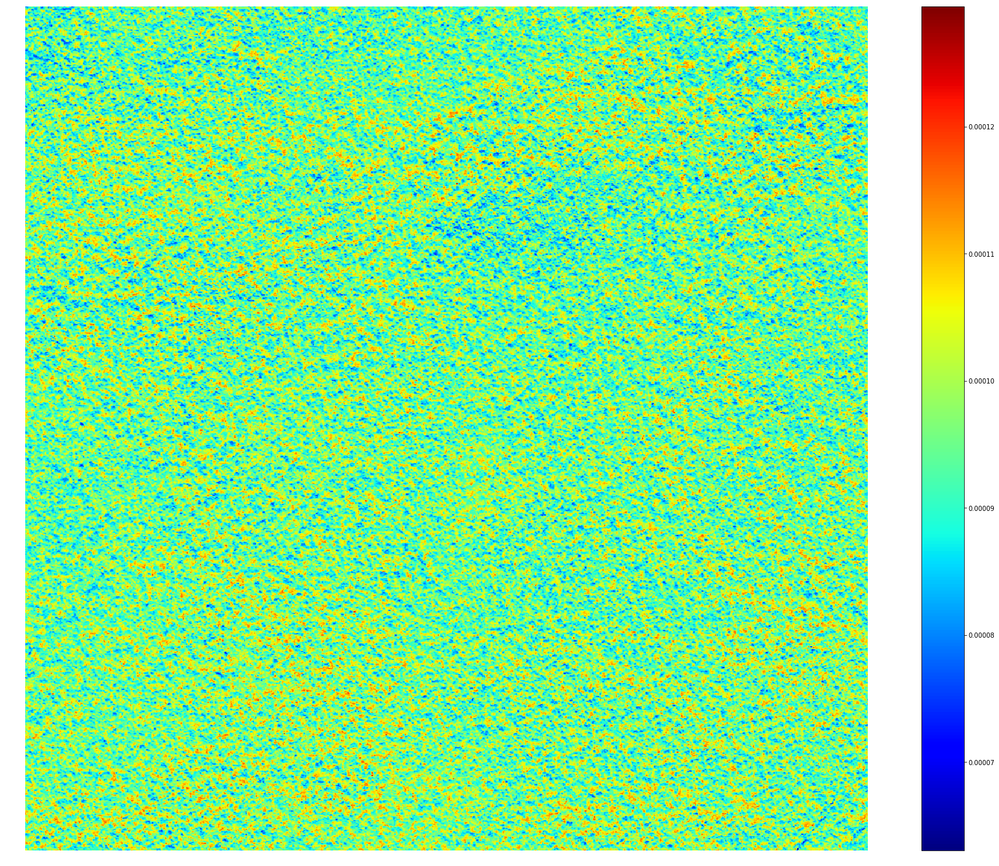

In [46]:
tredred = calc_ecarr_redred(bloom0_7_23aoi)
plot(tredred)

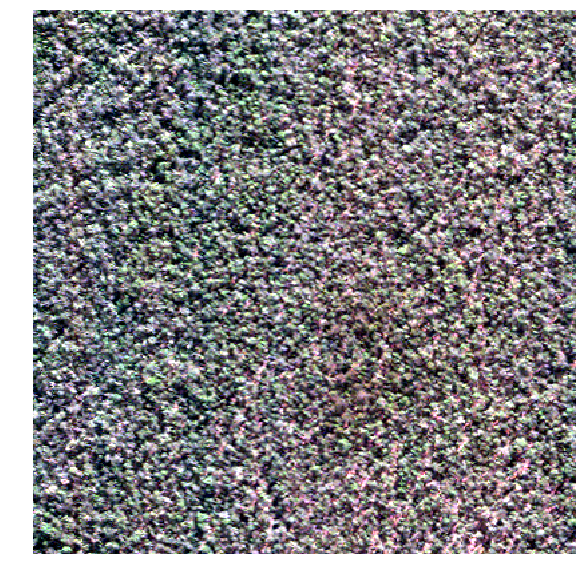

In [62]:
x0 = blooms.iloc[0]
bloom0_7_23aoi = bloom0_7_23.aoi(wkt=wkt.dumps(Point(x0.long,x0.lat).buffer(0.004)))
bloom0_7_23aoi.plot()

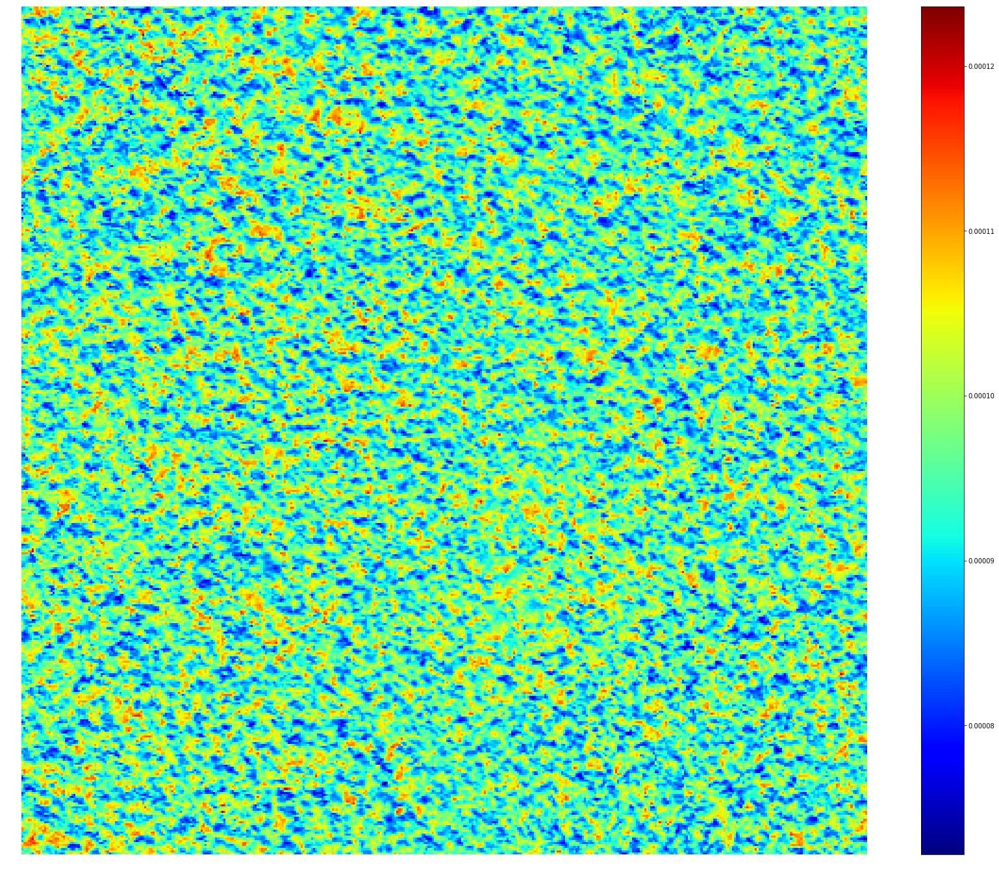

In [63]:
tredred = calc_ecarr_redred(bloom0_7_23aoi)
plot(tredred)

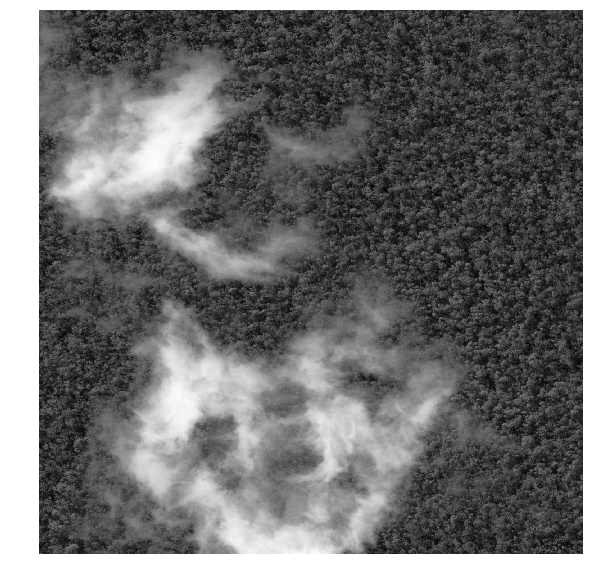

In [60]:
x0 = blooms.iloc[0]
bloom0_8_11aoi = bloom0_8_11.aoi(wkt=wkt.dumps(Point(x0.long,x0.lat).buffer(0.004)))
bloom0_8_11aoi.plot()

In [65]:
bloom0_8_11aoi.shape

(1, 1512, 1512)

In [36]:
findImageryFromLocation(1,"2018-01-20T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1030010083D1C500,2018-07-23T23:51:40.000Z,0
1,10200100756B3000,2018-07-12T02:51:24.000Z,70
2,1030010080257000,2018-07-04T23:50:01.000Z,99
3,102001006FA1C900,2018-03-15T02:51:48.000Z,24


In [37]:
order_id_1 = gbdx.ordering.order(['102001006FA1C900','1030010083D1C500'])
print(order_id_1)

e8ad9e50-6d66-463a-a2d4-f821b9eb0dc0


In [40]:
findImageryFromLocation(2,"2018-06-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010077902900,2018-08-11T02:50:53.000Z,1
4,10200100756B3000,2018-07-12T02:51:24.000Z,70


In [41]:
order_id_2 = gbdx.ordering.order(['1030010083D1C500','1020010077902900'])
print(order_id_2)

04b28dcb-80bc-4c24-a93e-9dbec33eaa9c


In [67]:
x2 = blooms.iloc[2]
bloom2_7_29 = CatalogImage('1030010083D1C500',bbox=Point(x2.long,x2.lat).buffer(0.01).bounds)
bloom2_8_11 = CatalogImage('1020010077902900',bbox=Point(x2.long,x2.lat).buffer(0.01).bounds)

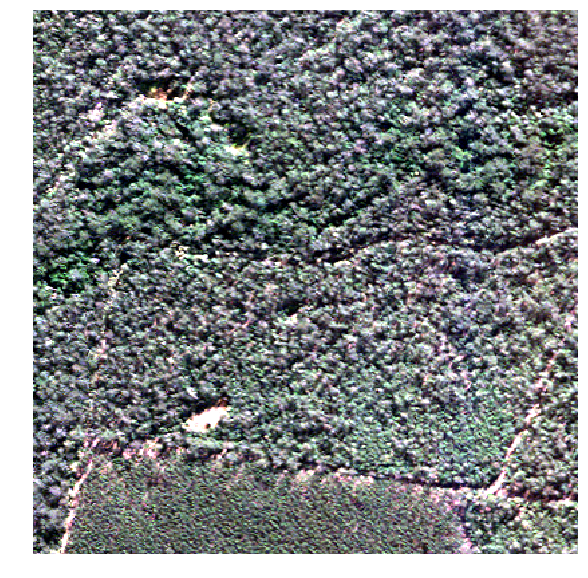

In [68]:
x2 = blooms.iloc[2]
bloom2_7_29aoi = bloom2_7_29.aoi(wkt=wkt.dumps(Point(x2.long,x2.lat).buffer(0.004)))
bloom2_7_29aoi.plot()

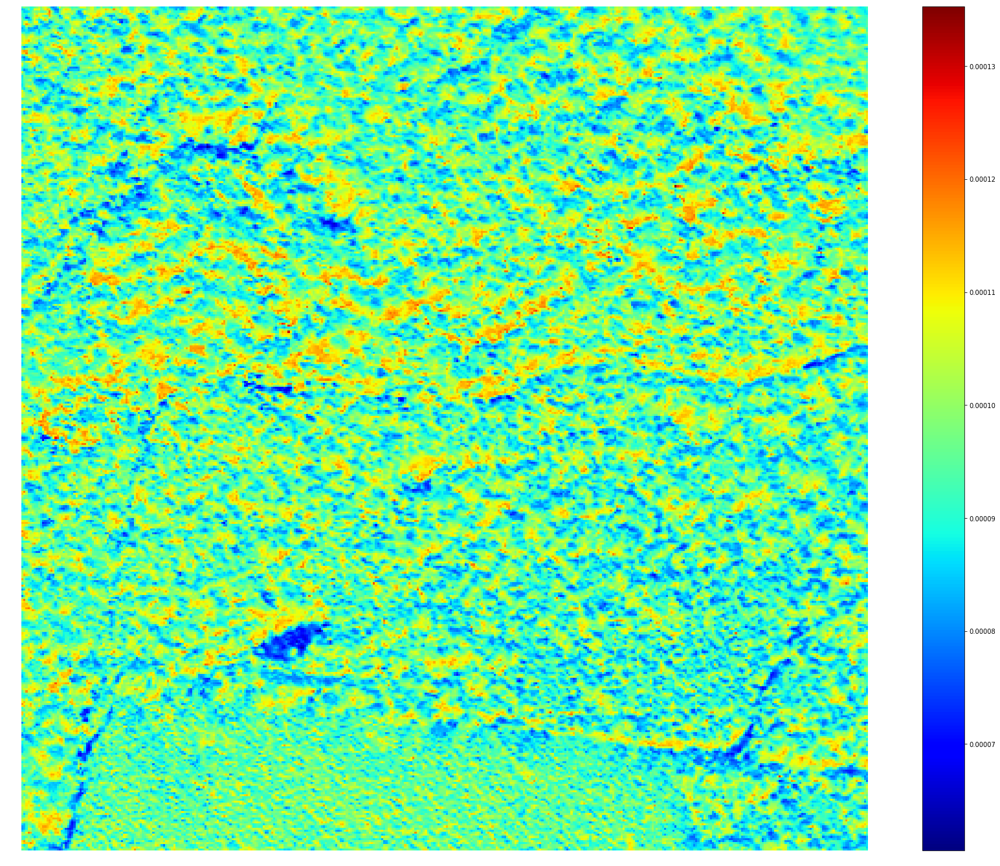

In [69]:
tredred_2_7_29 = calc_ecarr_redred(bloom2_7_29aoi)
plot(tredred_2_7_29)

In [44]:
findImageryFromLocation(3,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1020010077902900,2018-08-11T02:50:53.000Z,1
3,1050010011034800,2018-07-07T23:49:14.000Z,0


In [45]:
order_id_3 = gbdx.ordering.order(['1050010011034800','1020010077902900'])
print(order_id_3)

3886b58d-3065-48b9-b5dd-fc4714662c3e


In [100]:
x3 = blooms.iloc[3]
bloom3_7_7 = CatalogImage('1050010011034800',bbox=Point(x3.long,x3.lat).buffer(0.0001).bounds)
bloom3_8_11 = CatalogImage('1020010077902900',bbox=Point(x3.long,x3.lat).buffer(0.0001).bounds)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/gbdxtools/images/meta.py:440: UserWarning: Image does not contain specified geometry (153.14269, -28.967984000000005, 153.14289, -28.967784) not in (153.14351246, -29.017498677261948, 153.33322648263746, -28.46950254)
  warnings.warn(ae.args)


In [47]:
# Nothing after June
findImageryFromLocation(4,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,103001007E94D200,2018-06-29T00:10:44.000Z,0
2,104001003C9C3D00,2018-05-13T00:19:18.000Z,0
3,104001003C619200,2018-05-13T00:20:08.000Z,0


In [48]:
findImageryFromLocation(5,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,104001003C9C3D00,2018-05-13T00:19:18.000Z,0
2,104001003C619200,2018-05-13T00:20:08.000Z,0


In [49]:
findImageryFromLocation(6,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [50]:
findImageryFromLocation(7,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1050010010C79100,2018-07-03T00:05:31.000Z,24
2,1050010011034800,2018-07-07T23:49:14.000Z,0


In [51]:
findImageryFromLocation(8,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79100,2018-07-03T00:05:31.000Z,24
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [54]:
findImageryFromLocation(9,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79100,2018-07-03T00:05:31.000Z,24
1,1050010011034800,2018-07-07T23:49:14.000Z,0


In [55]:
findImageryFromLocation(10,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,1030010081367700,2018-06-29T00:10:36.000Z,0
2,1050010011034900,2018-07-07T23:49:46.000Z,0
3,103001007D710400,2018-06-12T23:58:32.000Z,25


In [56]:
findImageryFromLocation(11,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv,2018-08-22T23:55:37.000Z,1
2,1030010081367700,2018-06-29T00:10:36.000Z,0
3,1050010011034900,2018-07-07T23:49:46.000Z,0
4,103001007D710400,2018-06-12T23:58:32.000Z,25


In [7]:
ids = list(findImageryFromLocation(11,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")['identifier'])
print(ids)

['1050010010C79200', '6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv', '1050010011034900', '1030010081367700', '103001007D710400']


In [25]:
order_id_11 = gbdx.ordering.order(['1050010010C79200', '1050010011034900', '1030010081367700', '103001007D710400'])
print(order_id_11)

b485d3c0-87dd-46dc-bc0a-8753a5a8e512


In [57]:
findImageryFromLocation(12,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,6960f9af-bc8a-45ae-8807-4a9dc0fb7b59-inv,2018-08-22T23:55:37.000Z,1
2,1050010011034900,2018-07-07T23:49:46.000Z,0
3,1030010081367700,2018-06-29T00:10:36.000Z,0
4,103001007D710400,2018-06-12T23:58:32.000Z,25


In [58]:
findImageryFromLocation(13,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,103001008047C600,2018-08-09T00:02:50.000Z,0
2,1050010011034900,2018-07-07T23:49:46.000Z,0


In [59]:
order_id_13 = gbdx.ordering.order(['1050010011034900','103001008047C600'])
print(order_id_13)

3782c117-36e2-49d7-b4af-70a8aad15ca2


In [76]:
x13 = blooms.iloc[13]
#bloom13_7_7 = CatalogImage('103001008047C600',bbox=Point(x13.long,x13.lat).buffer(0.0001).bounds)
bloom13_8_9 = CatalogImage('1050010011034900',bbox=Point(x13.long,x13.lat).buffer(0.001).bounds)

/Library/Frameworks/Python.framework/Versions/3.6/lib/python3.6/site-packages/gbdxtools/images/meta.py:440: UserWarning: Image does not contain specified geometry (153.40938999999997, -28.649086999999994, 153.40958999999998, -28.648887) not in (153.22973353, -28.70904396757815, 153.40481063204817, -28.57780119)
  warnings.warn(ae.args)


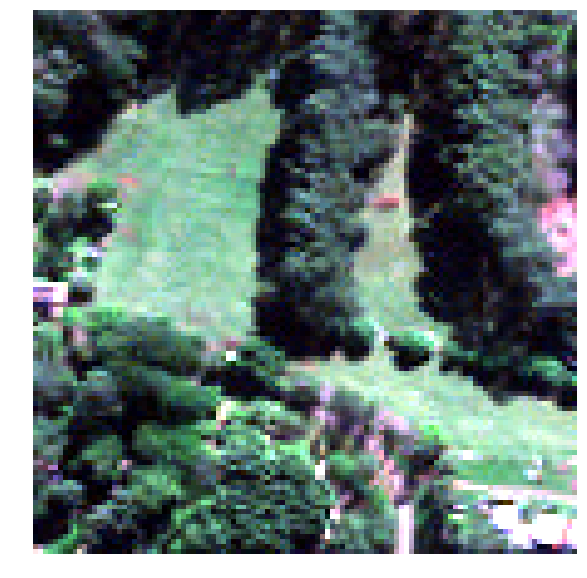

In [73]:
x13 = blooms.iloc[13]
bloom13_8_9aoi = bloom13_8_9.aoi(wkt=wkt.dumps(Point(x13.long,x13.lat).buffer(0.001)))
bloom13_8_9aoi.plot()

In [75]:
tredred_13_8_9 = calc_ecarr_redred(bloom13_8_9aoi)
plot(tredred_13_8_9)

IndexError: Index is not smaller than dimension 4 >= 4

In [91]:
x13

long    153.409490
lat     -28.648987
Name: 13, dtype: float64

In [61]:
findImageryFromLocation(14,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010C79200,2018-07-03T00:06:03.000Z,15
1,1050010011034900,2018-07-07T23:49:46.000Z,0
2,1030010081367700,2018-06-29T00:10:36.000Z,0
3,103001007D710400,2018-06-12T23:58:32.000Z,25


In [62]:
findImageryFromLocation(15,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1050010010BB8100,2018-06-29T23:57:06.000Z,6
1,1020010076229500,2018-07-29T02:53:46.000Z,18
2,1020010077902900,2018-08-11T02:50:53.000Z,1
3,1050010011034800,2018-07-07T23:49:14.000Z,0


In [63]:
findImageryFromLocation(16,"2018-05-01T00:00:00.000Z","2018-09-03T00:00:00.000Z")

,identifier,properties.timestamp,properties.cloudCover
0,1020010077902900,2018-08-11T02:50:53.000Z,1
1,1050010010BB8100,2018-06-29T23:57:06.000Z,6
2,1030010083D1C500,2018-07-23T23:51:40.000Z,0
3,1020010076229500,2018-07-29T02:53:46.000Z,18
4,10200100756B3000,2018-07-12T02:51:24.000Z,70
5,1020010075CBC300,2018-07-12T02:51:10.000Z,49


In [33]:
def findImageryFromLocationAugust(blooms,buffer_radius):
    fnd = 0
    for i in range(len(blooms)):
        x = blooms.iloc[i]
        bloomwkt = wkt.dumps(Point(x.long,x.lat).buffer(buffer_radius))
        types = [ "DigitalGlobeAcquisition" ]
        results = gbdx.catalog.search(searchAreaWkt=bloomwkt,
                          startDate="2018-08-01T00:00:00.000Z",
                          endDate="2018-09-01T00:00:00.000Z",
                          types=types)
    
        if(len(results)>0):
            print(i," ",len(results))
            print(results[0]['identifier'])
            print(results)
            fnd += 1
    return(fnd)

In [65]:
found = findImageryFromLocationAugust(blooms)

0
2
3
11
12
13
15
16


In [111]:
found = findImageryFromLocationAugust(blooms,0.001)

0   1
2   1
11   1
12   1
16   1


In [34]:
found = findImageryFromLocationAugust(blooms,0.01)

0   1
1020010077902900
[{'identifier': '1020010077902900', 'type': ['GBDXCatalogRecord', 'Acquisition', 'DigitalGlobeAcquisition', 'WV01'], 'properties': {'offNadirAngle_min': 23.703737, 'offNadirAngle_start': 26.651836, 'targetAzimuth_min': 283.58185, 'multiResolution_min': None, 'cloudCover': 1, 'sunAzimuth_max': 340.74985, 'targetAzimuth': 289.28458, 'multiResolution': None, 'catalogID': '1020010077902900', 'panResolution_max': 0.61282545, 'timestamp': '2018-08-11T02:50:53.000Z', 'sunAzimuth_min': 340.4722, 'browseURL': 'https://api.discover.digitalglobe.com/show?id=1020010077902900&f=jpeg', 'targetAzimuth_max': 295.07922, 'sunAzimuth': 340.61832, 'sunElevation_min': 42.72077, 'offNadirAngle': 25.06336, 'stereoPair': None, 'platformName': 'WORLDVIEW01', 'multiResolution_start': None, 'sunElevation': 43.192566, 'vendor': 'DigitalGlobe', 'scanDirection': 'Reverse', 'panResolution_end': 0.5878601, 'panResolution_start': 0.61282545, 'targetAzimuth_end': 283.58185, 'panResolution_min': 0

In [66]:
found

8

In [ ]:
#catalog_ids = [r['identifier'] for r in results]